#**Mount Google Drive**

In [ ]:
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


#**Navigate to the project directory**

In [ ]:
cd /content/drive/MyDrive/saudi-founding-day-object-detection

/content/drive/MyDrive/saudi-founding-day-object-detection


In [ ]:
!ls

annotations  images	       saudi-founding-day-object-detection.ipynb
data	     inference_images


In [ ]:
# Check the version of TensorFlow
import tensorflow as tf
print(tf.__version__)

2.11.0


In [ ]:
# Check the version of Pthon
import sys
print(sys.version)

3.8.10 (default, Nov 14 2022, 12:59:47) 
[GCC 9.4.0]


In [ ]:
# Import the necessary libraries 
import tensorflow as tf
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import shutil
import random
import cv2
import glob
import os
from google.colab.patches import cv2_imshow
import time
import warnings
warnings.filterwarnings('ignore')

#from object_detection.utils import label_map_util
#from object_detection.utils import visualization_utils as viz_utils

#**Clone the tensorflow models git repository & Install TensorFlow Object Detection API**

In [ ]:
# Clone the tensorflow models on the colab cloud vm
!git clone --q https://github.com/tensorflow/models.git

In [ ]:
# Navigate to /models/research folder to compile protos
%cd models/research

/content/drive/MyDrive/saudi-founding-day-object-detection/models/research


In [ ]:
# Compile protos.
!protoc object_detection/protos/*.proto --python_out=.

In [ ]:
# Install TensorFlow Object Detection API.
!cp object_detection/packages/tf2/setup.py .
!python -m pip install .

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/drive/MyDrive/saudi-founding-day-object-detection/models/research
  Preparing metadata (setup.py) ... done
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1696873 sha256=1cbbc151514084a64ee52a1905520f083364acce0989a3186f282dfecd7f6f53
  Stored in directory: /tmp/pip-ephem-wheel-cache-j_4f88hz/wheels/e8/a9/c0/3a834f0a57b908d70f2ccca6c162295b092af5e5eec092f3d9
Successfully built object-detection
  Attempting uninstall: object-detection
    Found existing installation: object-detection 0.1
    Uninstalling object-detection-0.1:
      Successfully uninstalled object-detection-0.1


#**Test the model builder**

In [ ]:
!pwd

/content/drive/MyDrive/saudi-founding-day-object-detection/models/research


In [ ]:
# testing the model builder
!python object_detection/builders/model_builder_tf2_test.py

2023-02-27 04:17:44.189514: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-02-27 04:17:44.189692: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-02-27 04:17:44.189718: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
2023-02-27 04:17:48.909051: E tensorflow/compiler/xla/stream_executor/cuda/cuda_driver.cc:267] failed call to c

#**Create CSV files**

#Upload a python script that converts the xml annotations to csv files for both train and test

In [ ]:
!pwd

/content/drive/MyDrive/saudi-founding-day-object-detection/models/research


In [ ]:
%cd /content/drive/MyDrive/saudi-founding-day-object-detection

/content/drive/MyDrive/saudi-founding-day-object-detection


In [ ]:
!ls

annotations  inference_images				xml_to_csv.py
data	     models
images	     saudi-founding-day-object-detection.ipynb


In [ ]:
!python3 xml_to_csv.py 

Successfully converted xml to csv.
Successfully converted xml to csv.


In [ ]:
cd data/

/content/drive/MyDrive/saudi-founding-day-object-detection/data


In [ ]:
!ls

label_map.pbtxt  test_labels.csv  train_labels.csv


#**Exploring the dataset (csv annotations)**

In [ ]:
%cd /content/drive/MyDrive/saudi-founding-day-object-detection/data

/content/drive/MyDrive/saudi-founding-day-object-detection/data


In [ ]:
# Import the necessary libraries 
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import shutil
import random
import cv2
import glob
import os
from google.colab.patches import cv2_imshow

In [ ]:
# Read the CSV file (for train annotations)
train_df = pd.read_csv('train_labels.csv')

In [ ]:
# Get summary information of the train dataframe
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 475 entries, 0 to 474
Data columns (total 8 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   filename  475 non-null    object
 1   width     475 non-null    int64 
 2   height    475 non-null    int64 
 3   class     475 non-null    object
 4   xmin      475 non-null    int64 
 5   ymin      475 non-null    int64 
 6   xmax      475 non-null    int64 
 7   ymax      475 non-null    int64 
dtypes: int64(6), object(2)
memory usage: 29.8+ KB


In [ ]:
# Get dimensions of the dataframe
train_df.shape

(475, 8)

In [ ]:
# View the first 5 rows
train_df.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
0,IMG-6133.jpg,750,928,Saudi_Founding_Day,59,7,747,928
1,IMG-6134.jpg,750,931,Saudi_Founding_Day,1,13,746,931
2,IMG-6135.jpg,750,931,Saudi_Founding_Day,356,23,750,931
3,IMG-6135.jpg,750,931,Saudi_Founding_Day,2,147,398,931
4,IMG-6136.jpg,749,930,Saudi_Founding_Day,270,364,542,837


Check the total number of images for the training phase(the expected output is 400 images)

In [ ]:
image_filename = train_df['filename']

In [ ]:
images_filename = image_filename.sort_values().unique()

In [ ]:
print(len(images_filename))

400


In [ ]:
# Read the CSV file (for test annotations)
test_df = pd.read_csv('test_labels.csv')

In [ ]:
# Get summary information of the test dataframe
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 136 entries, 0 to 135
Data columns (total 8 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   filename  136 non-null    object
 1   width     136 non-null    int64 
 2   height    136 non-null    int64 
 3   class     136 non-null    object
 4   xmin      136 non-null    int64 
 5   ymin      136 non-null    int64 
 6   xmax      136 non-null    int64 
 7   ymax      136 non-null    int64 
dtypes: int64(6), object(2)
memory usage: 8.6+ KB


In [ ]:
# Get dimensions of the dataframe
test_df.shape

(136, 8)

In [ ]:
# View the first 5 rows
test_df.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
0,IMG-6377.jpg,750,925,Saudi_Founding_Day,309,144,749,925
1,IMG-6378.jpg,749,947,Saudi_Founding_Day,1,5,663,947
2,IMG-6379.jpg,750,933,Saudi_Founding_Day,86,17,750,933
3,IMG-6380.jpg,750,925,Saudi_Founding_Day,143,6,750,925
4,IMG-6381.jpg,750,728,Saudi_Founding_Day,172,185,534,728


Check the total number of images for the testing phase(the expected output is 100 images)

In [ ]:
image_filename = test_df['filename']

In [ ]:
images_filename = image_filename.sort_values().unique()

In [ ]:
print(len(images_filename))

100


#**Display annotations on a random train image**

In [ ]:
img=train_df.iloc[[44]]
img

,filename,width,height,class,xmin,ymin,xmax,ymax
44,IMG-6191.jpg,750,918,Saudi_Founding_Day,264,192,494,850


In [ ]:
img_name=train_df.iloc[44, 0]
img_name

'IMG-6191.jpg'

In [ ]:
img_class=train_df.iloc[44, 3]
img_class

'Saudi_Founding_Day'

In [ ]:
img_xmin=train_df.iloc[44, 4]
img_xmin

264

In [ ]:
img_ymin=train_df.iloc[44, 5]
img_ymin

192

In [ ]:
img_xmax=train_df.iloc[44, 6]
img_xmax

494

In [ ]:
img_ymax=train_df.iloc[44, 7]
img_ymax

850

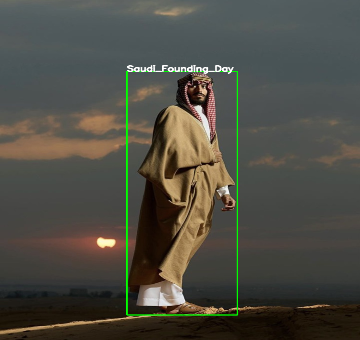

In [ ]:
path = '/content/drive/MyDrive/saudi-founding-day-object-detection/images/train/'
img_path = os.path.join(path,img_name)
image = cv2.imread(img_path)
start_point = img_xmax, img_ymax
end_point = img_xmin, img_ymin
# Green color in BGR
color = (0, 255, 0)
line_thickness= 2
image = cv2.rectangle(image, (int(start_point[0]), int(start_point[1])), (int(end_point[0]), int(end_point[1])), color, thickness=2)

x= int(end_point[0]) 
y= int(end_point[1]) 
image = cv2.putText(image, text=img_class, org=(x, y), fontFace=cv2.FONT_HERSHEY_SIMPLEX, fontScale=0.7, color=(255, 255, 255), thickness=2, lineType=cv2.LINE_AA)

image = cv2.resize(image, (360, 340))            
cv2_imshow(image) 


#**Create & upload the label_map.pbtxt file inside the data/ folder**

item {
  
    id: 1
    name: 'Saudi_Founding_Day' 
}

#**Create train.record & test.record files**

#Upload a python script that generates the train and test tfrecords

In [ ]:
!pwd

/content/drive/MyDrive/saudi-founding-day-object-detection/data


In [ ]:
%cd /content/drive/MyDrive/saudi-founding-day-object-detection

/content/drive/MyDrive/saudi-founding-day-object-detection


In [ ]:
!ls

annotations	      inference_images
data		      models
generate_tfrecord.py  saudi-founding-day-object-detection.ipynb
images		      xml_to_csv.py


In [ ]:
!python3 generate_tfrecord.py --csv_input=data/train_labels.csv  --output_path=data/train.record  --image_dir='images/train'

2023-03-02 06:13:04.577682: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-02 06:13:06.835354: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-02 06:13:06.835575: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-02 06:13:06.835602: W tensorfl

In [ ]:
!python3 generate_tfrecord.py --csv_input=data/test_labels.csv  --output_path=data/test.record  --image_dir='images/test'

2023-03-02 06:15:10.694668: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-02 06:15:11.834052: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-02 06:15:11.834200: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-02 06:15:11.834228: W tensorfl

In [ ]:
cd data/

/content/drive/MyDrive/saudi-founding-day-object-detection/data


In [ ]:
!ls

label_map.pbtxt  test_labels.csv  test.record  train_labels.csv  train.record


#**Download pre-trained model checkpoint**
#**inside the data/ folder**

In [ ]:
%cd /content/drive/MyDrive/saudi-founding-day-object-detection/data

/content/drive/MyDrive/saudi-founding-day-object-detection/data


In [ ]:
# Download the pre-trained model ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz into the data folder & unzip it.

!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz
!tar -xzvf ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz

--2023-02-27 04:57:19--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 142.250.148.128, 2607:f8b0:4001:c54::80
Connecting to download.tensorflow.org (download.tensorflow.org)|142.250.148.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 20515344 (20M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz’

ssd_mobilenet_v2_fp 100%[===================>]  19.56M  27.3MB/s    in 0.7s    

2023-02-27 04:57:20 (27.3 MB/s) - ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz’ saved [20515344/20515344]

ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/checkpoint
ssd_mobilenet_v2_fpnlite_320x320_coco17_tp

#**Make changes to the model pipeline config file**

Navigate to this configuration file

 ``/content/drive/MyDrive/saudi-founding-day-object-detection/models/research/object_detection/configs/tf2/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config``
 
open it and make the following changes :

* change ``num_classes`` to ``num_classes: 1``


* change ``fine_tune_checkpoint`` to  ``fine_tune_checkpoint: "/content/drive/MyDrive/saudi-founding-day-object-detection/data/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/ckpt-0"``

* change ``fine_tune_checkpoint_type`` to  ``fine_tune_checkpoint_type: "detection"``

* change ``batch_size`` to ``batch_size: 24``

* change ``num_steps`` to ``num_steps: 2000``

* change ``label_map_path`` to ``label_map_path: "/content/drive/MyDrive/saudi-founding-day-object-detection/data/label_map.pbtxt"``

* change ``input_path`` to ``input_path: "/content/drive/MyDrive/saudi-founding-day-object-detection/data/train.record"``

* change ``label_map_path`` to ``label_map_path: "/content/drive/MyDrive/saudi-founding-day-object-detection/data/label_map.pbtxt"``

* change ``input_path`` to ``input_path: "/content/drive/MyDrive/saudi-founding-day-object-detection/data/test.record"``


#**Load Tensorboard**

In [ ]:
%cd /content/drive/MyDrive/saudi-founding-day-object-detection/data

/content/drive/MyDrive/saudi-founding-day-object-detection/data


In [ ]:
# Load tensorboard

%load_ext tensorboard
%tensorboard --logdir '/content/drive/MyDrive/saudi-founding-day-object-detection/training'

<IPython.core.display.Javascript object>

#**To avoid the 'Runtime Disconnected Due to Inactivity' error in Google colab while training the model**


Ctrl+ Shift + I to open developer-settings in your web-browser ---> then go to console tab ---> and then type on the console prompt the following code (a JavaScript interval to click on the connect button every 60 seconds):


In [ ]:
function ClickConnect(){
    console.log("Working"); 
    document.querySelector("colab-toolbar-button").click() 
}

var colab = setInterval(ClickConnect,60000);

#**To stop the function (stop clicking on the button)**

Ctrl+ Shift + I to open developer-settings in your web-browser ---> then go to console tab ---> and then type on the console prompt the following code:

In [ ]:
clearInterval(colab)

#**Train the model**

In [ ]:
%cd /content/drive/MyDrive/saudi-founding-day-object-detection/models/research/object_detection

/content/drive/MyDrive/saudi-founding-day-object-detection/models/research/object_detection


In [ ]:
!python3 model_main_tf2.py --pipeline_config_path=/content/drive/MyDrive/saudi-founding-day-object-detection/models/research/object_detection/configs/tf2/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config --model_dir=/content/drive/MyDrive/saudi-founding-day-object-detection/training --alsologtostderr

2023-03-02 06:22:13.875368: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-02 06:22:15.235916: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-02 06:22:15.236049: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-02 06:22:15.236072: W tensorfl

#**Export the inference graph**

In [ ]:
%cd /content/drive/MyDrive/saudi-founding-day-object-detection/models/research/object_detection

/content/drive/MyDrive/saudi-founding-day-object-detection/models/research/object_detection


In [ ]:
# Export inference graph
!python exporter_main_v2.py --trained_checkpoint_dir=/content/drive/MyDrive/saudi-founding-day-object-detection/training --pipeline_config_path=/content/drive/MyDrive/saudi-founding-day-object-detection/models/research/object_detection/configs/tf2/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config --output_directory=/content/drive/MyDrive/saudi-founding-day-object-detection/data/inference_graph

2023-03-02 16:41:38.513211: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-02 16:41:39.422406: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-02 16:41:39.422507: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-03-02 16:41:39.422525: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT War

#**Download a font for object detection box**

In [ ]:
%cd /content/drive/MyDrive/saudi-founding-day-object-detection/models/research/object_detection

/content/drive/MyDrive/saudi-founding-day-object-detection/models/research/object_detection


In [ ]:
# different font-type for labels text.(This step is optional)
!wget https://freefontsdownload.net/download/160187/arial.zip
!unzip arial.zip -d .

%cd utils/
!sed -i "s/font = ImageFont.truetype('arial.ttf', 24)/font = ImageFont.truetype('arial.ttf', 50)/" visualization_utils.py
%cd ..

--2023-03-02 17:07:07--  https://freefontsdownload.net/download/160187/arial.zip
Resolving freefontsdownload.net (freefontsdownload.net)... 104.21.75.182, 172.67.180.27, 2606:4700:3036::6815:4bb6, ...
Connecting to freefontsdownload.net (freefontsdownload.net)|104.21.75.182|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 172821 (169K) [application/force-download]
Saving to: ‘arial.zip’

arial.zip           100%[===================>] 168.77K  --.-KB/s    in 0.08s   

2023-03-02 17:07:08 (1.96 MB/s) - ‘arial.zip’ saved [172821/172821]

Archive:  arial.zip
@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@@
@#################################@
@#        Downloaded from        #@
@#                               #@
@#   www.FreeFontsDownload.net   #@
@#                               #@
@# ---------- More site -------- #@
@#      https://funnytv.net      #@
@#                               #@
@#                               #@
@#################################@
@@@@@@@@@@@@@@@@@@

#**Test the custom Object Detection model:**

#**1- Run inference and make predictions on images**

In [ ]:
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils

In [ ]:
#Loading the saved_model
PATH_TO_SAVED_MODEL="/content/drive/MyDrive/saudi-founding-day-object-detection/data/inference_graph/saved_model"
print('Loading model...', end='')

# Load saved model and build the detection function
detect_fn=tf.saved_model.load(PATH_TO_SAVED_MODEL)
print('Done!')

In [ ]:
#Loading the label_map
category_index=label_map_util.create_category_index_from_labelmap("/content/drive/MyDrive/saudi-founding-day-object-detection/data/label_map.pbtxt",use_display_name=True)

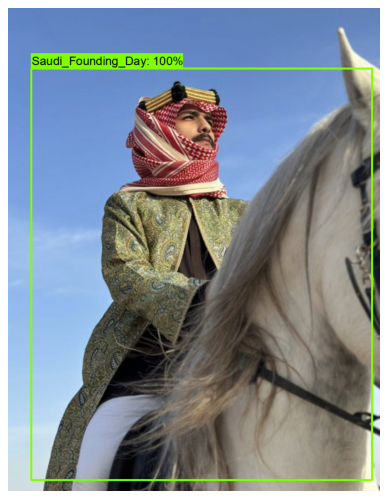

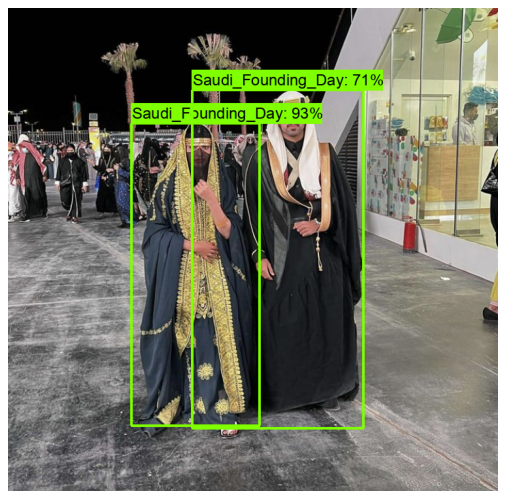

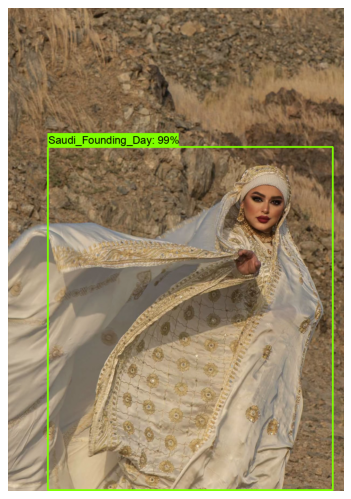

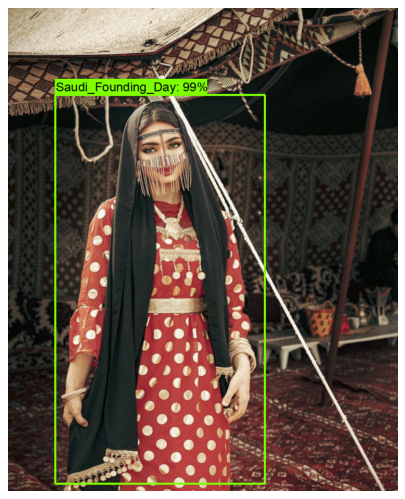

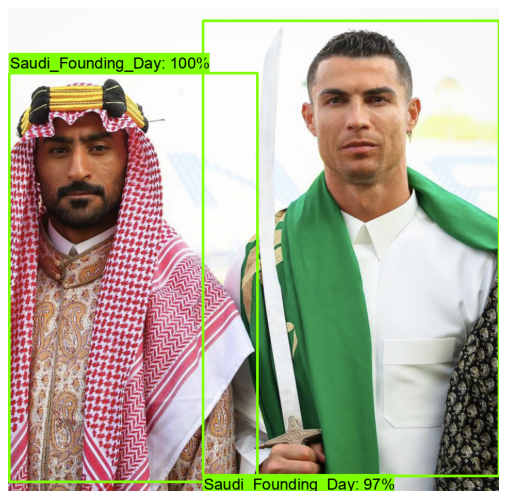

...

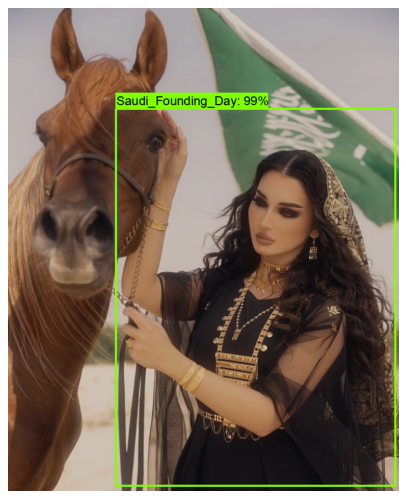

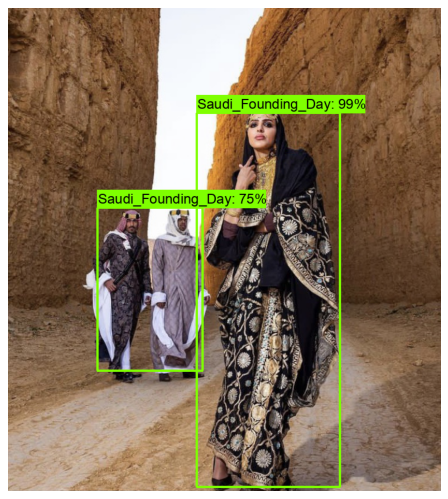

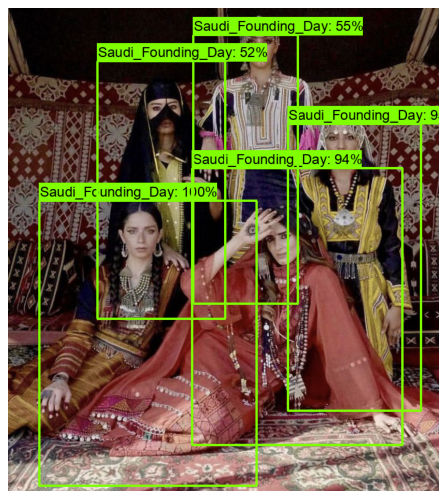

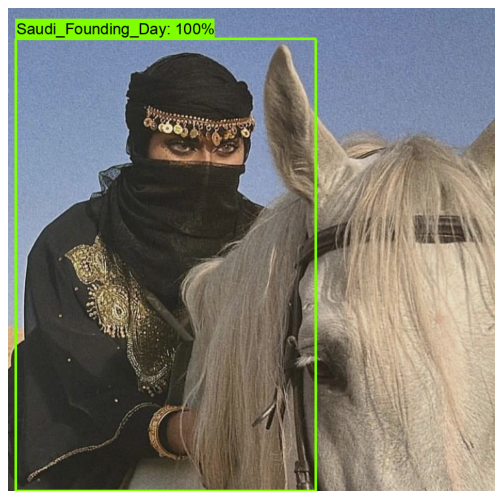

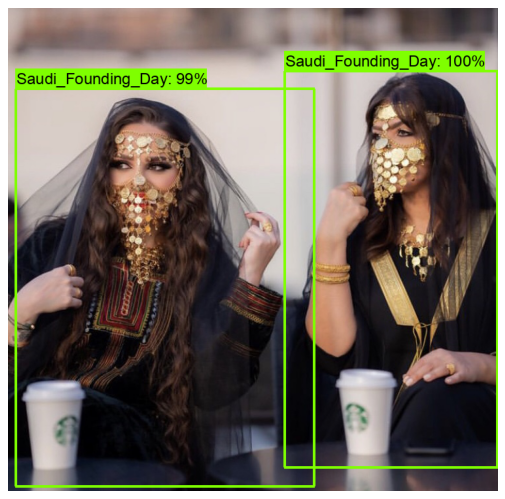

In [ ]:
img_dir = "/content/drive/MyDrive/saudi-founding-day-object-detection/inference_images/*.*"

for file in glob.glob(img_dir):

      def load_image_into_numpy_array(path):

        return np.array(Image.open(path))

      # Preprocess the image for inferecne

      image_np = load_image_into_numpy_array(file)
      # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
      input_tensor = tf.convert_to_tensor(image_np)
      # The model expects a batch of images, so add an axis with `tf.newaxis`.
      input_tensor = input_tensor[tf.newaxis, ...]

      detections = detect_fn(input_tensor)

      # All outputs are batches tensors.
      # Convert to numpy arrays, and take index [0] to remove the batch dimension.
      # We're only interested in the first num_detections.
      num_detections = int(detections.pop('num_detections'))
      detections = {key: value[0, :num_detections].numpy()
                    for key, value in detections.items()}
      detections['num_detections'] = num_detections

      # detection_classes should be ints.
      detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

      image_np_with_detections = image_np.copy()

      viz_utils.visualize_boxes_and_labels_on_image_array(
            image_np_with_detections,
            detections['detection_boxes'],
            detections['detection_classes'],
            detections['detection_scores'],
            category_index,
            use_normalized_coordinates=True,
            max_boxes_to_draw=200,
            min_score_thresh=.4, # Adjust this value to set the minimum probability boxes to be classified as True
            agnostic_mode=False)

      IMAGE_SIZE = (12, 8) # Output display size as you want

      %matplotlib inline
      plt.figure(figsize=IMAGE_SIZE, dpi=80)
      plt.axis("off")
      plt.imshow(image_np_with_detections)
      plt.show()


#**2- Run inference and make predictions on video**

In [ ]:
import os
import time
import tensorflow as tf
import cv2
import numpy as np

from utils import label_map_util
from PIL import Image
from google.colab.patches import cv2_imshow
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils

from IPython.display import HTML
from base64 import b64encode

# Path to saved model  

PATH_TO_SAVED_MODEL = "/content/drive/MyDrive/saudi-founding-day-object-detection/data/inference_graph/saved_model"

# Load label map and obtain class names and ids
#label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
category_index=label_map_util.create_category_index_from_labelmap("/content/drive/MyDrive/saudi-founding-day-object-detection/data/label_map.pbtxt",use_display_name=True)


def visualise_on_image(image, bboxes, labels, scores, thresh):
    (h, w, d) = image.shape
    for bbox, label, score in zip(bboxes, labels, scores):
        if score > thresh:
            xmin, ymin = int(bbox[1]*w), int(bbox[0]*h)
            xmax, ymax = int(bbox[3]*w), int(bbox[2]*h)

            cv2.rectangle(image, (xmin, ymin), (xmax, ymax), (0,255,0), 2)
            cv2.putText(image, f"{label}: {int(score*100)} %", (xmin, ymin), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255), 2)
    return image

if __name__ == '__main__':
    
    # Load the model
    print("Loading saved model ...")
    detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)
    print("Model Loaded!")
    
    # Video Capture (video_file)
    video_capture = cv2.VideoCapture("/content/drive/MyDrive/saudi-founding-day-object-detection/inference_videos/input-1.mp4")
    start_time = time.time()
    
    frame_width = int(video_capture.get(3))
    frame_height = int(video_capture.get(4))
    #fps = int(video_capture.get(5))
    size = (frame_width, frame_height)
    
    # Initialize video writer
    result = cv2.VideoWriter('/content/drive/MyDrive/saudi-founding-day-object-detection/result_videos/output-1.mp4', cv2.VideoWriter_fourcc(*'MJPG'),15, size)

    while True:
      ret, frame = video_capture.read()
      if not ret:
          print('Unable to read video / Video ended')
          break
    
      frame = cv2.flip(frame, 1)
      image_np = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
      # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
      # The model expects a batch of images, so also add an axis with `tf.newaxis`.
      input_tensor = tf.convert_to_tensor(image_np)[tf.newaxis, ...]

      # Pass frame through detector
      detections = detect_fn(input_tensor)

      # Set detection parameters

      score_thresh = 0.4   # Minimum threshold for object detection
      max_detections = 1

      # All outputs are batches tensors.
      # Convert to numpy arrays, and take index [0] to remove the batch dimension.
      # We're only interested in the first num_detections.
      scores = detections['detection_scores'][0, :max_detections].numpy()
      bboxes = detections['detection_boxes'][0, :max_detections].numpy()
      labels = detections['detection_classes'][0, :max_detections].numpy().astype(np.int64)
      labels = [category_index[n]['name'] for n in labels]

      # Display detections
      visualise_on_image(frame, bboxes, labels, scores, score_thresh)

      end_time = time.time()
      fps = int(1/(end_time - start_time))
      start_time = end_time 
      cv2.putText(frame, f"FPS: {fps}", (50,50), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 1)
      #cv2_imshow(frame)
      
      # Write output video
      result.write(frame)

    video_capture.release()


Loading saved model ...
Model Loaded!
Unable to read video / Video ended
